# SARSA Algorithm for OpenAI Gym FrozenLake 

## Imports

In [1]:
import gym 
import numpy as np
import math
# import random
import matplotlib.pyplot as plt

## Environment

In [2]:
env = gym.make("FrozenLake-v1") 
# env = gym.make("FrozenLake-v1", render_mode= "human") # use this one to visualize
print("Action space:", env.action_space)
print("State space:", env.observation_space)

Action space: Discrete(4)
State space: Discrete(16)


## Hyperparameters

In [3]:
state_size = env.observation_space.n
action_space = env.action_space.n

# We are going to decay our exploration rate over time, but not too fast. We want to explore less as we're more sure of getting the balance right. 
def get_explore_rate(t, EXPLORE_RATE_MIN = 0.01):
    return max(EXPLORE_RATE_MIN, min(1, 1.0 -  math.log10((t+1)/25)))

# We are going to decay the learning rate as well so that we don't miss any maximums. 
def get_learning_rate(t, LEARNING_RATE_MIN = 0.01):
    return max(LEARNING_RATE_MIN, min(0.5, 1.0 - math.log10((t+1)/25)))

DISCOUNT_FACTOR = 0.95
# state_action_vals = np.random.randn(state_size, action_space)
Q_TABLE = np.zeros((state_size,) + (action_space,))

test_episodes = 50
test_every = 1000
test_episode = []
rewards = []

## Training

In [4]:
# Select the action that we want from the current state. This takes in the explore_rate as well.
def select_action(state, explore_rate):
    sample = np.random.uniform()

    # Explore the sample space at random based on the explore_rate
    if sample < explore_rate:
        return env.action_space.sample()
    
    # Perform the action that gets us the state with the highest Q-value
    else:
        return Q_TABLE[state].argmax()

### SARSA Formula Recap
$Q^{new}(s_{k}, a_{k}) = Q^{old}(s_{k}, a_{k}) + \alpha(r_{k} + \gamma Q^{old}(s_{k+1}, a_{k+1}) - Q^{old}(s_{k}, a_{k}))$

In [7]:
def simulate():
    
    # Get initial learning and explore rates
    EXPLORE_RATE = get_explore_rate(0)
    LEARNING_RATE = get_learning_rate(0)

    for episode in range(10000):

        observ = env.reset()
        state = observ[0]

        action = select_action(state, EXPLORE_RATE)
        
        move = 0
        done = False
        while not done:
            
            # env.render() # Unless render="human", comment this out

            next_state, reward, terminated, truncated, _ = env.step(action)
            done = terminated or truncated

            next_action = select_action(state, EXPLORE_RATE)

            Q_TABLE[state, action] += LEARNING_RATE * (reward + DISCOUNT_FACTOR * Q_TABLE[next_state, next_action] - Q_TABLE[state, action])

            state, action = next_state, next_action

            move += 1

            print("\nEpisode = %d" % episode)
            print("Moves = %d" % move)
            print("Action: %d" % action)
            print("State: %s" % str(next_state))
            print("Reward: %f" % reward)
            print("Explore rate: %f" % EXPLORE_RATE)
            print("Learning rate: %f" % LEARNING_RATE)

            print("")

        print("Episode %d finished after %f moves" % (episode, move))
            
        if episode % test_every == 0:
            total_rewards = 0
            for _ in range(test_episodes):
                
                observ = env.reset()
                state = observ[0]

                done = False
                while not done:

                    action = Q_TABLE[state].argmax()

                    state, reward, terminated, truncated, _ = env.step(action)
                    done = terminated or truncated

                    total_rewards += reward

            rewards.append(total_rewards / test_episodes)
            test_episode.append(episode)

        EXPLORE_RATE = get_explore_rate(episode)
        LEARNING_RATE =  get_learning_rate(episode)

In [8]:
simulate()


Episode = 0
Moves = 1
Action: 2
State: 0
Reward: 0.000000
Explore rate: 1.000000
Learning rate: 0.500000


Episode = 0
Moves = 2
Action: 2
State: 4
Reward: 0.000000
Explore rate: 1.000000
Learning rate: 0.500000


Episode = 0
Moves = 3
Action: 2
State: 5
Reward: 0.000000
Explore rate: 1.000000
Learning rate: 0.500000

Episode 0 finished after 3.000000 moves

Episode = 1
Moves = 1
Action: 3
State: 0
Reward: 0.000000
Explore rate: 1.000000
Learning rate: 0.500000


Episode = 1
Moves = 2
Action: 0
State: 0
Reward: 0.000000
Explore rate: 1.000000
Learning rate: 0.500000


Episode = 1
Moves = 3
Action: 0
State: 0
Reward: 0.000000
Explore rate: 1.000000
Learning rate: 0.500000


Episode = 1
Moves = 4
Action: 2
State: 0
Reward: 0.000000
Explore rate: 1.000000
Learning rate: 0.500000


Episode = 1
Moves = 5
Action: 2
State: 0
Reward: 0.000000
Explore rate: 1.000000
Learning rate: 0.500000


Episode = 1
Moves = 6
Action: 3
State: 4
Reward: 0.000000
Explore rate: 1.000000
Learning rate: 0.50000

In [9]:
Q_TABLE

array([[1.78675739e-02, 8.92249370e-03, 9.19112126e-03, 8.39558602e-03],
       [5.72233368e-03, 1.61232911e-04, 3.52614704e-05, 2.85646368e-04],
       [3.83516780e-05, 8.91653651e-07, 1.36184546e-06, 4.94852138e-05],
       [8.18590617e-06, 0.00000000e+00, 0.00000000e+00, 1.20581113e-05],
       [2.09045450e-02, 1.37459167e-02, 7.04716007e-03, 5.17188702e-03],
       [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00],
       [3.11394325e-03, 0.00000000e+00, 0.00000000e+00, 7.22886831e-07],
       [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00],
       [2.82867005e-02, 7.80633332e-02, 2.12424306e-02, 3.22596783e-02],
       [1.07680679e-01, 1.49684616e-01, 1.89096084e-02, 1.55149032e-02],
       [3.29252628e-01, 1.53760580e-01, 4.33618082e-03, 2.55760741e-03],
       [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00],
       [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00],
       [3.73516142e-02, 3.13883181e-01, 6.61535778e

## Plots

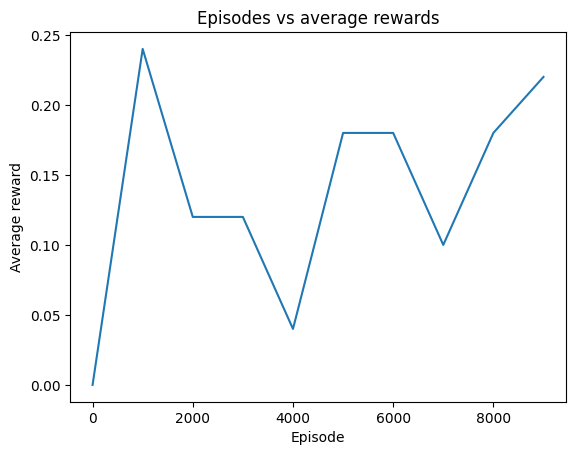

In [10]:
fig, ax = plt.subplots()
ax.plot(test_episode, rewards)
ax.set_title('Episodes vs average rewards')
ax.set_xlabel('Episode')
_ = ax.set_ylabel('Average reward')